In [1]:
import numpy as np
import pandas as pd
import pickle
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
from matplotlib import cm
import matplotlib as mpl    
import seaborn as sns

from utils_ens import get_Xy_tt
from sklearn import metrics

mpl.rc('font',family='serif')

In [2]:
# get df:
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/computerome/currents/preds_df_tt.pkl', 'rb')
#pkl_file = open('/home/projects/ku_00017/data/generated/currents/rf_selected_features.pkl', 'rb')
df = pickle.load(pkl_file)
pkl_file.close()

In [3]:
# get df:
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/computerome/currents/rf_class_4f_df_tt.pkl', 'rb')
#pkl_file = open('/home/projects/ku_00017/data/generated/currents/rf_hp_df.pkl', 'rb')
df_tt = pickle.load(pkl_file)
pkl_file.close()

In [4]:
# you forgot...
def get_AUC_samples(df=df):

    y_binary = (df[df['train']==0]['y'] > 0) * 1

    AUC_list = []

    for i in df_tt['test_preds']:

        AUC = metrics.roc_auc_score(y_binary, i)
        AUC_list.append(AUC)

    AUC_samples = np.array(AUC_list)

    return(AUC_samples)

AUC_samples = get_AUC_samples()

In [22]:
def plot_curves():

    X_train, y_train, X_test, y_test = get_Xy_tt(local = True)

    rf_pred_mean = np.array(df_tt['test_preds']).mean(axis = 0)
    rf_pred_std = np.array(df_tt['test_preds']).std(axis = 0)

    random_ap_base = (y_test>0).mean()
    rf_mean_precision, rf_mean_recall, _ = metrics.precision_recall_curve(y_test, rf_pred_mean) 
    rf_mean_AP = metrics.average_precision_score(y_test, rf_pred_mean)

    rf_mean_fpr, rf_mean_tpr, _ =  metrics.roc_curve(y_test, rf_pred_mean) 
    rf_mean_AUC = metrics.roc_auc_score(y_test, rf_pred_mean)

    # -------------------------------------------------------------------------
    # Fig
    plt.figure(figsize = [10,5])

    # ---------------------------------------------------------------------------
    #PR/AP
    plt.subplot(1,2,1)

    plt.title('PR curve')
    plt.ylabel('precision', fontsize = 12)
    plt.xlabel('recall', fontsize = 12)
    plt.xticks(fontsize = 12)
    plt.yticks(fontsize = 12)

    plt.hlines(random_ap_base, 0, 1, linestyles='dashed', color = 'gray')

    for i in df_tt['PR']: 
        
        plt.plot(i[1], i[0], color = 'blue', alpha = 0.1)
        
    plt.plot(rf_mean_recall,rf_mean_precision, color = 'orange', alpha = 1)

        
    rf_mean_line = mlines.Line2D([], [], color='orange', marker='_', markersize=15, label=f'RF-ensemble mean, AP: {rf_mean_AP:.3}')
    rf_line = mlines.Line2D([], [], color='blue', marker='_', markersize=15, label=f'RF-ensemble range: {df_tt["AP"].min():.3}-{df_tt["AP"].max():.3}')
    random_ap_line = mlines.Line2D([], [], color='gray', linestyle='--', markersize=15, label='random baseline')

    plt.legend(handles=[rf_line, rf_mean_line, random_ap_line],frameon = False, fontsize = 10, loc="upper right")


    # ---------------------------------------------------------------------------
    #ROC/AUC
    plt.subplot(1,2,2)

    plt.title('RUC curve')
    plt.ylabel('true positive rate', fontsize = 12)
    plt.xlabel('false positive rate', fontsize = 12)
    plt.xticks(fontsize = 12)
    plt.yticks(fontsize = 12)

    plt.plot([0, 1], [0, 1], color='gray', linestyle='--')

    for i in df_tt['ROC']: 
        
        plt.plot(i[0], i[1], color = 'blue', alpha = 0.1)
        
    plt.plot(rf_mean_fpr,rf_mean_tpr, color = 'orange', alpha = 1)

        
    rf_mean_line = mlines.Line2D([], [], color='orange', marker='_', markersize=15, label=f'RF-ensemble mean, AP: {rf_mean_AUC:.3}')
    rf_line = mlines.Line2D([], [], color='blue', marker='_', markersize=15, label=f'RF-ensemble range: {AUC_samples.min():.3}-{AUC_samples.max():.3}')
    random_auc_line = mlines.Line2D([], [], color='gray', linestyle='--', markersize=15, label='random baseline')

    plt.legend(handles=[rf_line, rf_mean_line, random_auc_line],frameon = False, fontsize = 10, loc="lower right")

    fig_title = f'test_plots/curves.jpg'
    plt.savefig(fig_title, bbox_inches="tight", dpi=300)

    plt.show()


X_train: (3203100, 24)
y_train: (3203100,)
X_test: (384372, 24)
y_test: (384372,)


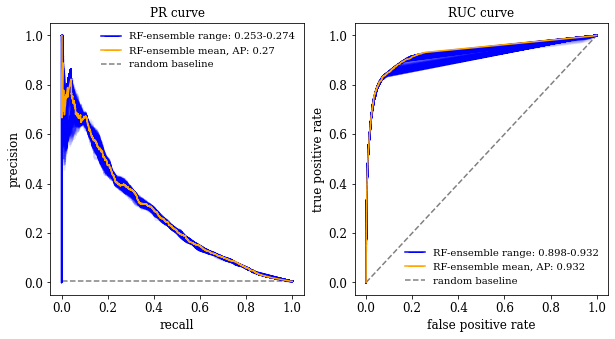

In [23]:
plot_curves()